In [1]:
import numpy as np
import datasets
import tensorflow as tf
import matplotlib.pyplot as plt
import convtas
import IPython.display as ipd
import librosa.display
import librosa
import sys
sys.path.append('../audio_processing')
import audio_processing as ap


## Getting The audio from the model.

Okay so we finally have our output from the model, but what does any of this mean? The best way to interpret it is to look at the shape of the output which is in this format: $(M, C, K, L)$ where:

- $M$ = 100; Batch number, remember each batch observation is 2 tensors each one correlating to the left/right audio channel.
- $C$ = 4; Source number, each number correlates to drums, bass, other, and vocals respectively.
- $K$ = 40; Index/number of overlapping chunks of waveform.
- $L$ = 16; Length of a chunk/sample of data. For this study we will refer to these as chunks.
- Another important parameter to know is 'overlap', which is the amount of samples the chunks overlap to their adjacent chunk. In this audio batch, the overlap = 8.

The main question is how do i combine the overlapping chunks back into an approximation of the audio signal while trying to keep some level of each chunks' features in the estimated audio?

![Overlapping Chunks](https://github.com/jambory/MSS-Project/blob/in_progress/images/overlapping_chunks.png)

The process turns out to be quite simple actually. What you end up doing is just taking the first 8 samples of the chunk and putting it into your constructed data, and do that for every single separated chunk.

Because the training data is comprised of randomly sampled chunks of 150 different songs, if we try to listen to one of the outputs, its so short that it isn't really perceptible. I'm going to use a different song for demonstration purposes.

In [48]:
# Loads data and displays waveform. Song: Kids-MGMT
f = 'wav/kids.wav'
data, samplerate = ap.load_waveform(f)
print('True Signal')
ipd.display(ipd.Audio(data=data, rate=samplerate))

True Signal


def decode_wav
for i in range(num_portions):
        for j in range(40):
            begin = (i * 40 + j) * (16 - 8)
            end = begin + 16
            model_input[i][j] = data[begin:end]

In [ ]:
cnn = convtas.ConvTasNet()
output = 

In [32]:
separated = output[:, :, :, :(16 - param.overlap)]
separated = np.reshape(separated, (param.C, num_samples_output))

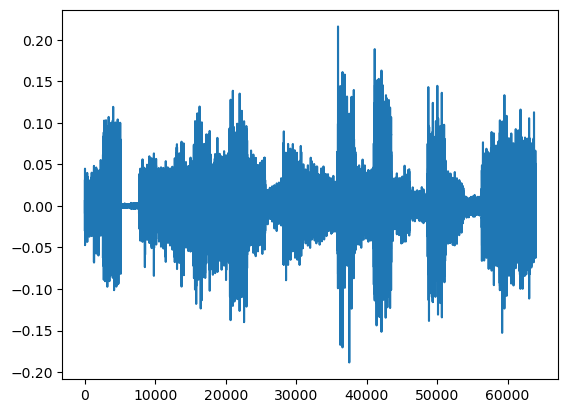

In [34]:
plt.plot(separated[0])

In [33]:
separated.shape

(4, 64000)

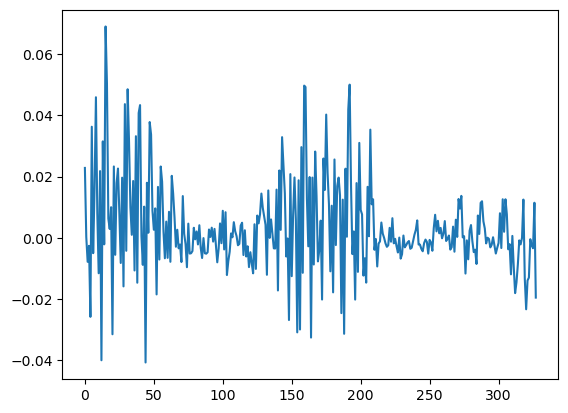

In [42]:
plt.plot(audio_est)

In [45]:
actual_audio = y_batches[0,0,3]
actual_audio.shape

(40, 16)

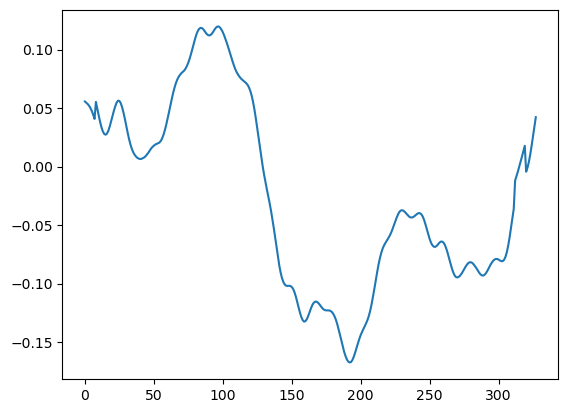

In [46]:
audio_construct = decompose_audio(actual_audio)
plt.plot(audio_construct)

In [48]:
print('True Signal')
ipd.display(ipd.Audio(data=audio_est, rate=44100))
print('Signal through model')
ipd.display(ipd.Audio(data=actual_audio, rate=44100))

True Signal


Signal through model


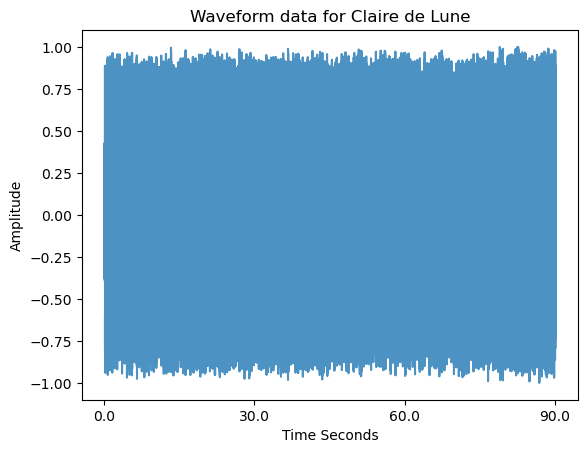

In [5]:
# Loads data and displays waveform.
f = 'wav/kids.wav'
data, samplerate = ap.load_waveform(f)
ap.display_waveform(data, samplerate)

12424

In [13]:
model_input = np.zeros((num_portions, 40, 16))

In [14]:
for i in range(num_portions):
        for j in range(40):
            begin = (i * 40 + j) * (16 - 8)
            end = begin + 16
            model_input[i][j] = data[begin:end]

In [20]:
model_input.shape

(12424, 40, 16)

In [26]:
reconstructed.shape

(4075072,)

In [27]:
data.shape

(3975995,)

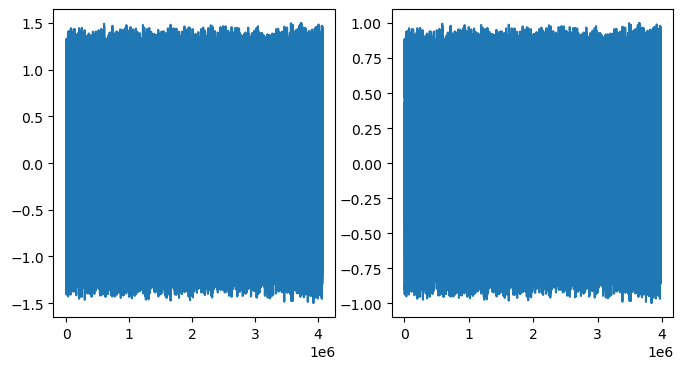

In [29]:
fig, axes = plt.subplots(1,2, figsize=(8,4))
axes[0].plot(reconstructed)

axes[1].plot(data)

In [30]:
print('True Signal')
ipd.display(ipd.Audio(data=data, rate=samplerate))
print('Signal through model')
ipd.display(ipd.Audio(data=reconstructed, rate=samplerate))

True Signal


Signal through model


In [16]:
model_input.shape

(12424, 40, 16)

In [36]:
kids_model_output = cnn(model_input[:1000])

In [37]:
kids_model_output.shape

TensorShape([1000, 4, 40, 16])

In [39]:
num_samples_output = 1000 * 40 * (16 - 8)
num_samples_output

320000

In [42]:
separated = kids_model_output[:, :, :, :(16 - 8)]
separated = np.reshape(separated, (4, num_samples_output))

In [46]:
reconstructed = model_input[:1000,:, :8]
reconstructed = np.reshape(reconstructed, (1000*40*8))

In [47]:
print('True Signal')
ipd.display(ipd.Audio(data=reconstructed, rate=samplerate))

True Signal


In [44]:
print('Signal through model')
ipd.display(ipd.Audio(data=separated[0], rate=samplerate))

Signal through model
